# Lab 3: Rigid Registration


## Reminder

Among other useful information, it tells you to make a copy of this Colab notebook BEFORE you try to run it:

- Make a copy on your own Colab space by clicking on the `copy to drive` button.
- Alternatively you could go to the menu `File > Save a copy in Drive`
- Then, open your new file on a new tap and rename it, and you’re ready to start tinkering with the code
- Look carefully at the existing code before you execute it. Try to understand what the code is doing. Part of your learning outcome is to understand it, and we will quiz you about it.
- In several places of the code, you’ll find `#__________TO DO_________`.
There you should introduce your code.

Once you are done, submit this notebook by the lab deadline, with the cells executed and including your **answers** in the text fields in $\color{red}{\text{red}}$ color.

Use `$\color{red}{\text{This is my red text}}$` to write "$\color{red}{\text{This is my red text}}$".

## Loading the required files
You can load into the temporal workspace of Colab the following required files:

*   the data files `LAB3_data`. Download them from Moodle to your computer and uncompress them.

You should copy these files from your computer using the function `files.upload()`. Use the `Choose Files` button to upload both files from your local drive.

Don't use Safari, it is preferable to use google chrome

## Goals of this lab
The aim of this lab is to develop competences regarding teamwork and problem solving. By developing the proposed activity you will also become familiar with SIFT and planar transformations for rigid image registration: how to extract invariant features, how to describe them, how to match them and how to use them to compute a homography. Most importantly, this should give you some feeling about the strengths and weaknesses of local feature-based approaches.
It should be noted that before you start this activity, you should read Lowe’s paper on SIFT:

David G. Lowe, "Distinctive image features from scale-invariant keypoints," International Journal of Computer Vision, 60, 2 (2004), pp. 91-110.
The paper can be downloaded from [here](http://www.cs.ubc.ca/~lowe/papers/ijcv04.pdf).

This lab requires working in teams of two (exceptionally three) students. The labs will be organized on the first lab session by the professor who acts as lab instructor.

Students will have to:

1. Test Lowe’s implementation on a set of images showing some skin lesions.
2. Register the images pairs corresponding to the same skin lesion using Lowe’s implementation to detect and match features, and implementing different motion models by estimating homography matrices.
3. Improve the registration accuracy by means of data normalization for the homography estimation.

## Additional tools
In this lab, we will also make use of:
- NumPy, a popular library for scientific computing
- Matplotlib, a popular library for plotting data
- Routines in the aux_utils.py file, which should already be in the local directory
- Opencv
-...

In [ ]:
import math, copy
import numpy as np
from matplotlib.pyplot import figure, title
from numpy import genfromtxt
import matplotlib.pyplot as plt

#import seaborn as sns
#sns.set_theme()

#from aux_utils import plt_house_x, plt_contour_wgrad, plt_gradients, plt_cost_vs_theta1
from IPython import display
from time import sleep
# import opencv
import cv2

import pandas as pd
import io

#Import math Library
import math
import scipy.linalg as linalg

In [ ]:
def imshow(image, figsize=(12,12), bgr=True, title=None):
    plt.figure(figsize=figsize)
    im = image.copy()
    if bgr:
        im = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    plt.imshow(im)
    if title is not None:
        plt.title(title)
    plt.show()

def strip_black_rim(image):
    # Convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Find all non-black pixels (thresholding)
    _, binary = cv2.threshold(gray, 1, 255, cv2.THRESH_BINARY)

    # Find contours of the non-black area
    contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Get the bounding box of the largest contour
    x, y, w, h = cv2.boundingRect(contours[0])

    # Crop the image
    cropped_image = image[y:y+h, x:x+w]
    return cropped_image

skin1 = lambda: cv2.imread("data/skin1.png", cv2.IMREAD_UNCHANGED)
skin2 = lambda: cv2.imread("data/skin2.png", cv2.IMREAD_UNCHANGED)
bgr2rgb = lambda img: cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
bgr2gray = lambda img: cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
blend = lambda img1, img2, ratio: cv2.addWeighted(img1, ratio, img2, 1-ratio, 0)

## Detect SIFT Keypoints and Descriptors
Now we will register real images.

Register skin1.png with skin2.png

First, load and show the images.

Also set SIFT to detect keypoints on images

$\color{yellow}{\text{To be done during 1st lab session}}$

In [ ]:
skin_1 = skin1()
skin_2 = skin2()
# imshow(skin_1)
# imshow(skin_2)

# cvt color
gray_1= cv2.cvtColor(skin_1,cv2.COLOR_BGR2GRAY)
gray_2= cv2.cvtColor(skin_2,cv2.COLOR_BGR2GRAY)
gray_1_= cv2.cvtColor(strip_black_rim(skin_1),cv2.COLOR_BGR2GRAY)
gray_2_= cv2.cvtColor(strip_black_rim(skin_2),cv2.COLOR_BGR2GRAY)

# detect
sift = cv2.SIFT_create()
kp_1, des_1 = sift.detectAndCompute(gray_1,None)
kp_2, des_2 = sift.detectAndCompute(gray_2,None)
kp_1_, des_1_ = sift.detectAndCompute(gray_1_,None)
kp_2_, des_2_ = sift.detectAndCompute(gray_2_,None)

## Plot the Keypoints
$\color{yellow}{\text{To be done during 1st lab session}}$

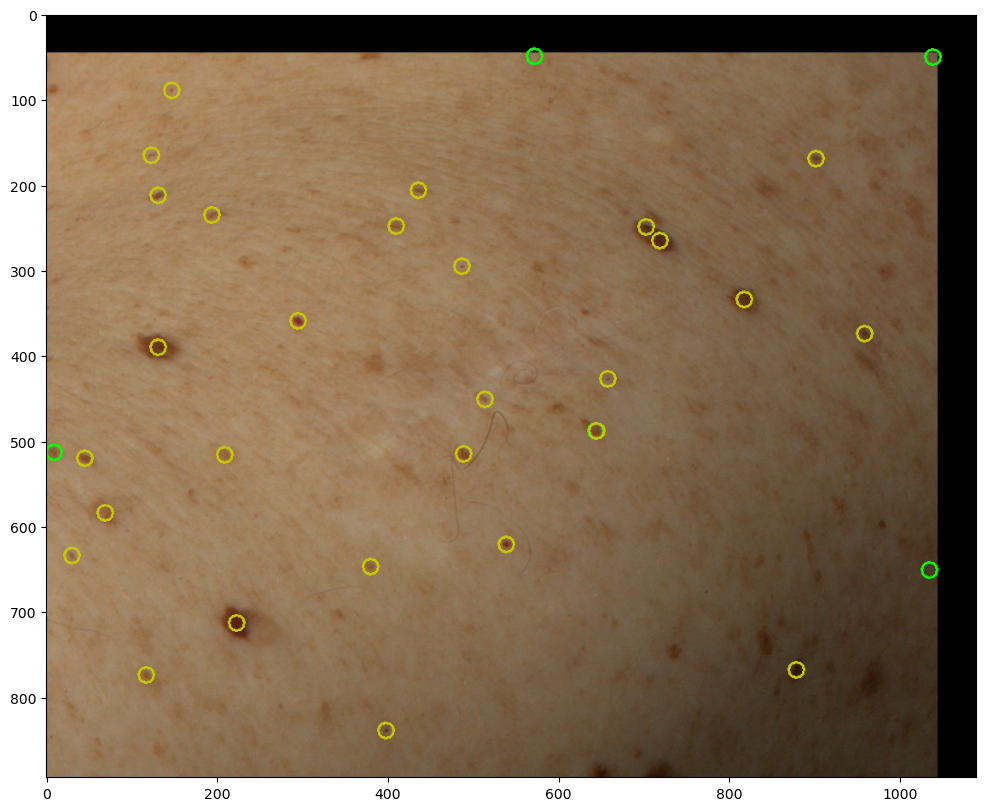

In [91]:
# 1st image
skin_1_kp = skin1()

for i, keypoint in enumerate(kp_1):
    point = (np.array(keypoint.pt))
    cv2.circle(skin_1_kp,(int(point[0]),int(point[1])),9,(255,0,0),2)
for i, keypoint in enumerate(kp_1_):
    point = (np.array(keypoint.pt))
    point[1] += 45
    cv2.circle(skin_1_kp,(int(point[0]),int(point[1])),9,(200,0,150),2)

# Blue points are only present in the non-masked SIFT points
imshow(skin_1_kp)

# 2nd image
skin_2_kp = skin_2.copy()

for i, keypoint in enumerate(kp_2):
    point = (np.array(keypoint.pt))
    cv2.circle(skin_2_kp,(int(point[0]),int(point[1])),9,(0,255,0),2)
for i, keypoint in enumerate(kp_2_):
    point = (np.array(keypoint.pt))
    point[1] += 45
    cv2.circle(skin_2_kp,(int(point[0]),int(point[1])),9,(0,200,200),2)

# Green points are only present in the non-masked SIFT points
imshow(skin_2_kp)

## Compute Brute Force Matching

$\color{yellow}{\text{To be done during 1st lab session}}$

In [92]:
# Initialize the Brute-Force Matcher
bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)

# Match descriptors
matches = bf.match(des_1, des_2)
matches_ = bf.match(des_1_, des_2_)

# Sort the matches based on distance (best matches first)
matches = sorted(matches, key=lambda x: x.distance)
matches_ = sorted(matches_, key=lambda x: x.distance)

Plot matches

$\color{yellow}{\text{To be done during 1st lab session}}$

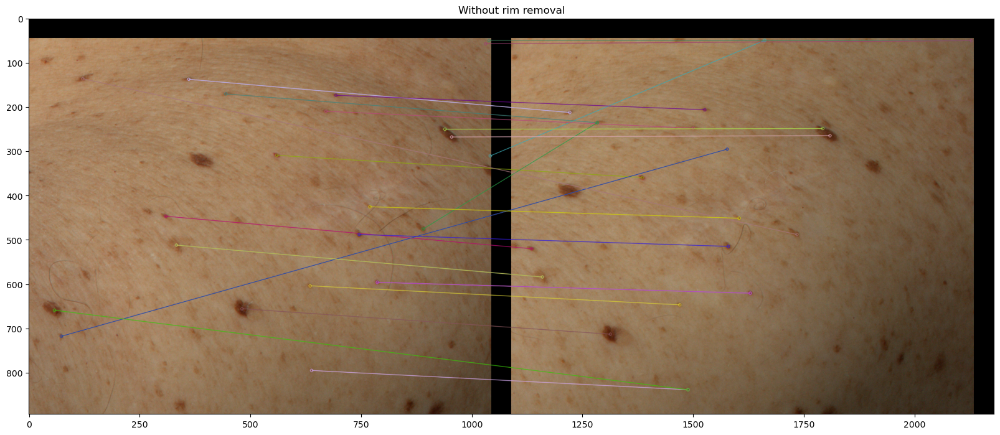

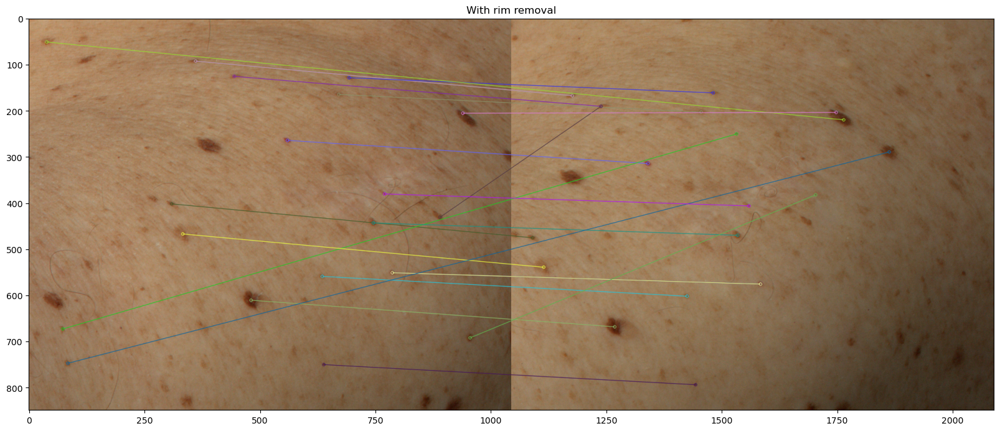

In [93]:
# Draw matches
matched_image = cv2.drawMatches(skin_1, kp_1, skin_2, kp_2, matches[:], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

matched_image_ = cv2.drawMatches(strip_black_rim(skin_1), kp_1_, strip_black_rim(skin_2), kp_2_, matches_[:], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

imshow(matched_image, title="Without rim removal")
imshow(matched_image_, title="With rim removal")

## Lowe match

Now implement by yourself a function to match keypoints and descriptors between these 2 images

Implement the function `SIFT_match` following the article "Distinctive image features from scale-invariant keypoints" David G. Lowe.

$\color{yellow}{\text{To be done during 1st lab session}}$

NOTE: MODIFICATIONS TO THE CV function

In [94]:
def Lowe_match(des1, des2, ratio_thresh=0.75, distance_tresh=1):
    good_matches = []
    for i, d1 in enumerate(des1):
        # Compute distances between the descriptor d1 and all descriptors in des2
        distances = np.linalg.norm(des2 - d1, axis=1)

        # Find indices of the closest and second-closest descriptors
        if len(distances) > 1:
            sorted_indices = np.argsort(distances)
            best_match_index = sorted_indices[0]
            second_best_match_index = sorted_indices[1]
            # print(distances[:5])

            # Apply Lowe's ratio test
            if distances[best_match_index] / distances[second_best_match_index] < ratio_thresh :
                # Create a match similar to OpenCV's DMatch format
                match = cv2.DMatch(i, best_match_index, distances[best_match_index])
                good_matches.append(match)

    # Sort matches by distance for further refinement or visualization
    good_matches = sorted(good_matches, key=lambda x: x.distance)
    return good_matches

Recompute the matches using your function

$\color{yellow}{\text{To be done during 1st lab session}}$

In [95]:
lowe_matches = Lowe_match(des_1, des_2, ratio_thresh=0.7)
lowe_matches_ = Lowe_match(des_1_, des_2_, ratio_thresh=0.7)

Plot the new matches

$\color{yellow}{\text{To be done during 1st lab session}}$

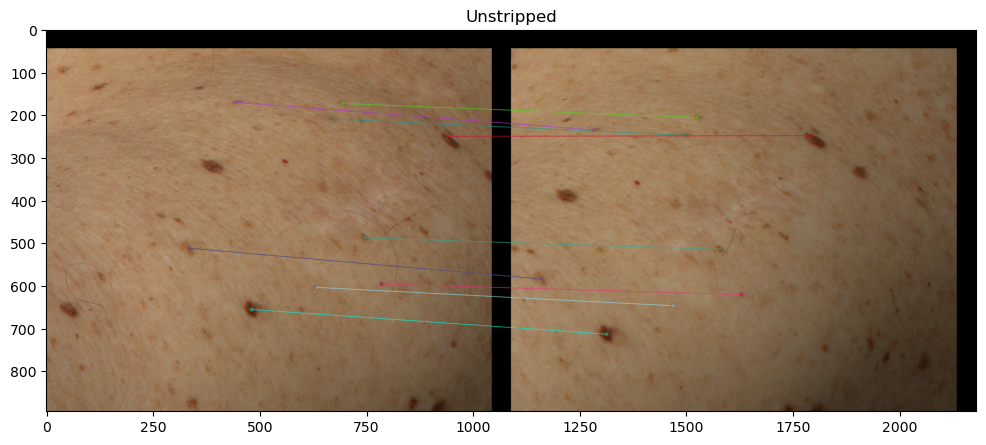

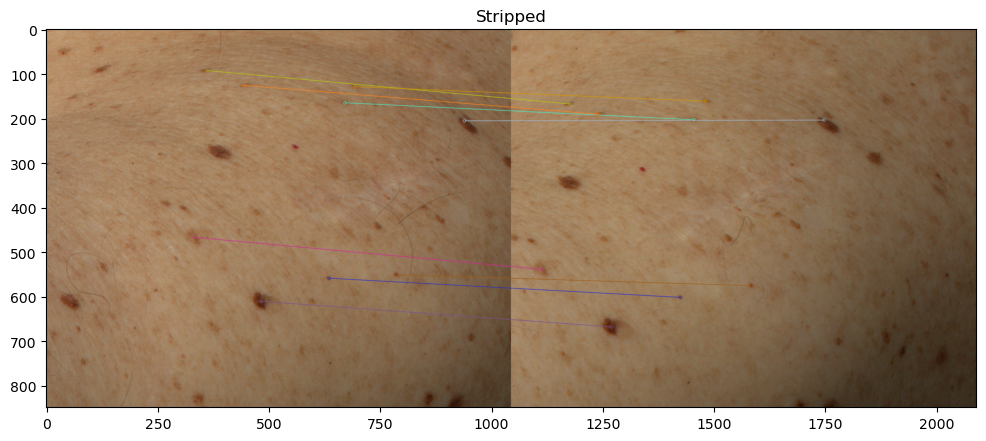

In [122]:
matched_image = cv2.drawMatches(skin_1, kp_1, skin_2, kp_2, lowe_matches[:], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
imshow(matched_image, title="Unstripped")

matched_image_ = cv2.drawMatches(strip_black_rim(skin_1), kp_1_, strip_black_rim(skin_2), kp_2_, lowe_matches_[:], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
imshow(matched_image_, title="Stripped")

## Compute Homographies

Compute the homography between both images using opencv function `cv2.findHomography`

Plot one of the images warped according to the obtained Homography

$\color{yellow}{\text{To be done during 1st lab session}}$

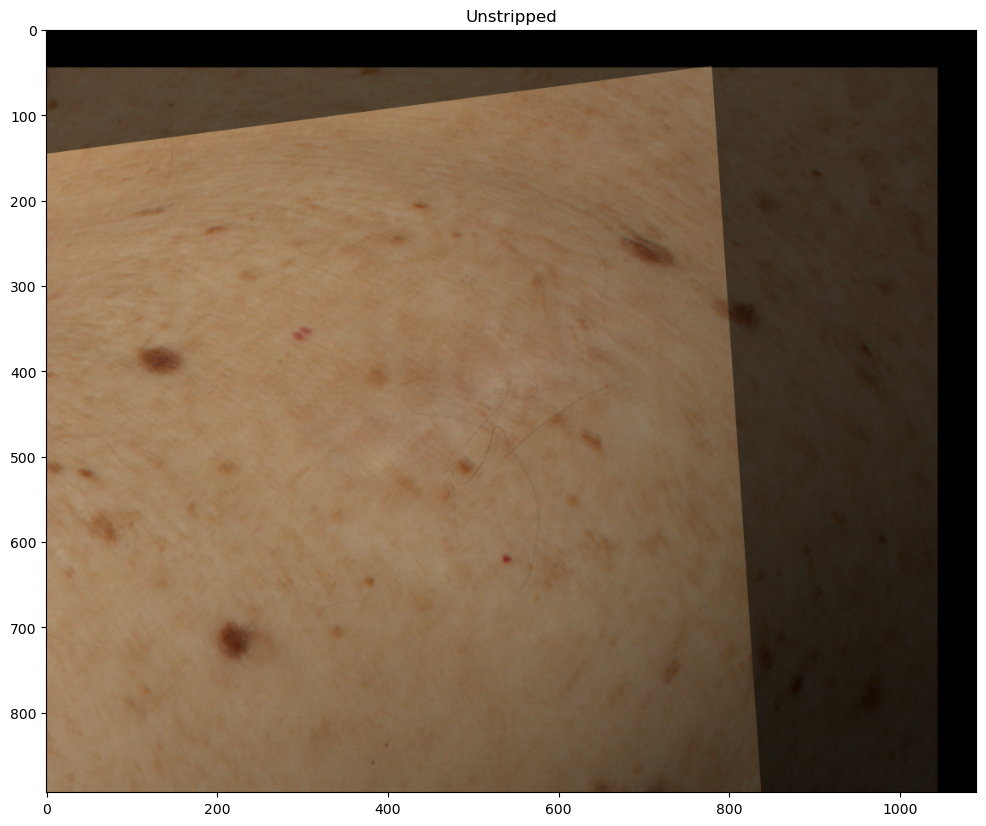

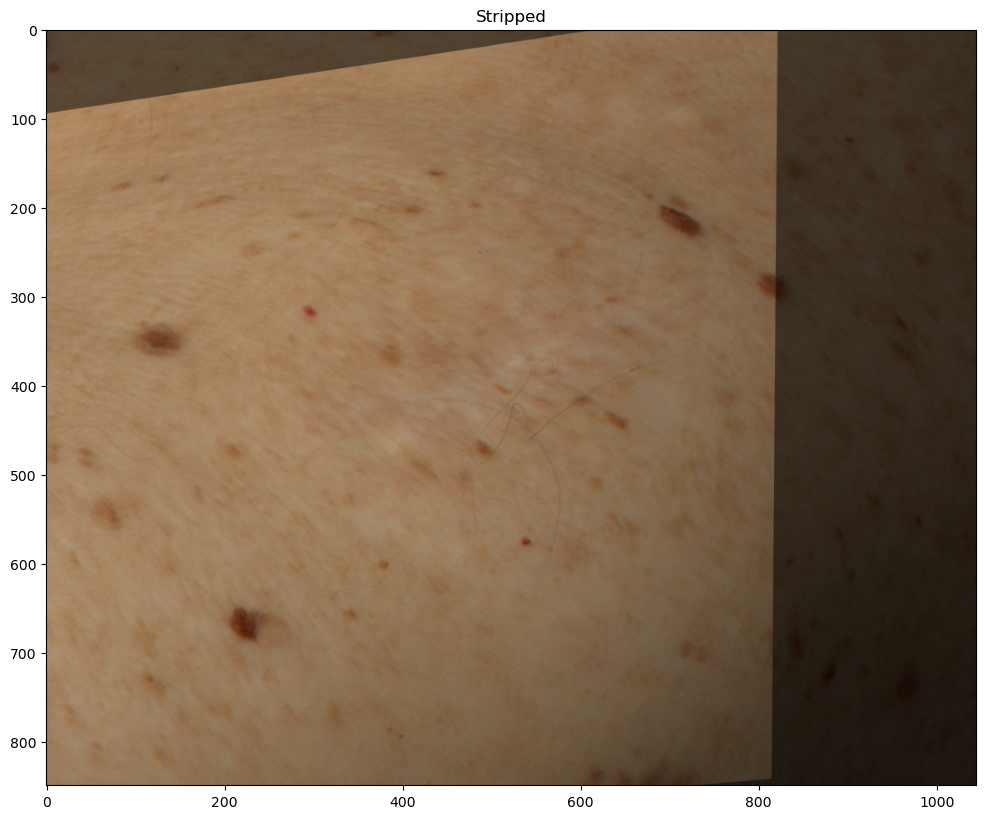

In [123]:
# Compute the homography (skin_1 -> skin_2)
src_points = np.float32([kp_1[m.queryIdx].pt for m in lowe_matches])
dst_points = np.float32([kp_2[m.trainIdx].pt for m in lowe_matches])

H1, status = cv2.findHomography(src_points, dst_points, cv2.RANSAC)
warped1 = cv2.warpPerspective(skin_1, H1, tuple(skin_2.shape[:2])[::-1])
imshow(blend(warped1, skin_2, 0.5), title="Unstripped")

# Compute the homography (skin_1 -> skin_2)
src_points = np.float32([kp_1_[m.queryIdx].pt for m in lowe_matches_])
dst_points = np.float32([kp_2_[m.trainIdx].pt for m in lowe_matches_])

H1_, status_ = cv2.findHomography(src_points, dst_points, cv2.RANSAC)
warped1_ = cv2.warpPerspective(strip_black_rim(skin_1), H1_, tuple(strip_black_rim(skin_2).shape[:2])[::-1])
imshow(blend(warped1_, strip_black_rim(skin_2), 0.5), title="Stripped")

## Homography estimation

$\color{yellow}{\text{To be done during 2nd lab session}}$

Next, we will load images `00.png`, `01.png`, `02.png` and `03.png`

In [98]:
img00c = cv2.imread("data/00.png", cv2.IMREAD_UNCHANGED)
img01c = cv2.imread("data/01.png", cv2.IMREAD_UNCHANGED)
img02c = cv2.imread("data/02.png", cv2.IMREAD_UNCHANGED)
img03c = cv2.imread("data/03.png", cv2.IMREAD_UNCHANGED)

ims = [img00c, img01c, img02c, img03c]

And the csv files with keypoints

In [99]:
keypoints_00 = genfromtxt('data/Keypoints_00.csv', delimiter=',', skip_header = 0)
keypoints_01 = genfromtxt('data/Keypoints_01.csv', delimiter=',', skip_header = 0)
keypoints_02 = genfromtxt('data/Keypoints_02.csv', delimiter=',', skip_header = 0)
keypoints_03 = genfromtxt('data/Keypoints_03.csv', delimiter=',', skip_header = 0)

keypoints = np.array((keypoints_00,keypoints_01,keypoints_02,keypoints_03))

print(np.shape(keypoints))

[[[1266.3    232.7  ]
  [1266.3    320.63 ]
  [1266.3    407.7  ]
  [1266.3    495.64 ]
  [1266.3    582.7  ]
  [1266.3    670.63 ]
  [1266.3    757.7  ]
  [1266.3    845.63 ]
  [1178.4    232.7  ]
  [1178.5    320.5  ]
  [1178.5    408.   ]
  [1178.5    495.5  ]
  [1178.5    583.   ]
  [1178.5    670.5  ]
  [1178.5    758.   ]
  [1178.3    845.65 ]
  [1091.3    232.7  ]
  [1091.     320.5  ]
  [1091.     408.   ]
  [1091.     495.5  ]
  [1091.     583.   ]
  [1091.     670.5  ]
  [1091.     758.   ]
  [1091.3    845.63 ]
  [1003.4    232.7  ]
  [1003.5    320.5  ]
  [1003.5    408.   ]
  [1003.5    495.5  ]
  [1003.5    583.   ]
  [1003.5    670.5  ]
  [1003.5    758.   ]
  [1003.3    845.65 ]
  [ 916.3    232.7  ]
  [ 916.     320.5  ]
  [ 916.     408.   ]
  [ 916.     495.5  ]
  [ 916.     583.   ]
  [ 916.     670.5  ]
  [ 916.     758.   ]
  [ 916.3    845.64 ]
  [ 828.37   232.7  ]
  [ 828.5    320.5  ]
  [ 828.5    407.99 ]
  [ 828.5    495.5  ]
  [ 828.5    583.   ]
  [ 828.5 

Now plot img00c, img01c, img02c, img03c all images using `cv2_imshow` from `opencv`

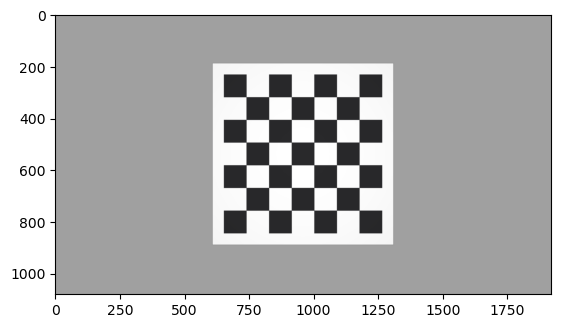

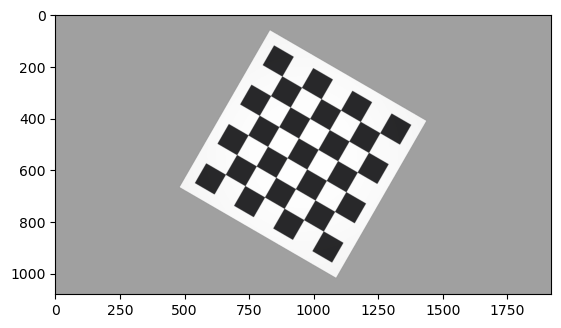

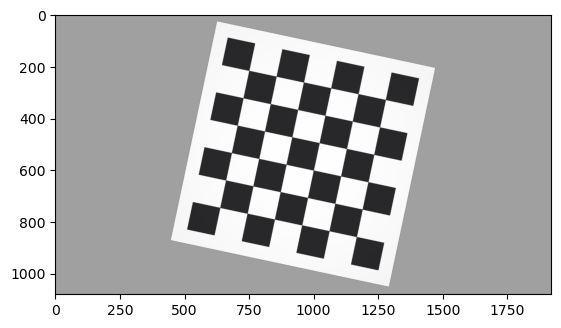

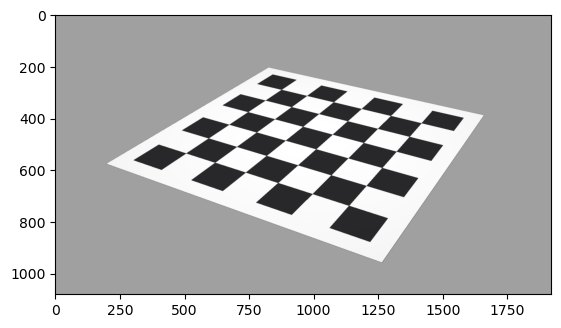

In [100]:
for i in ims:
    plt.imshow(i)
    plt.show()

Plot Keypoints on images.

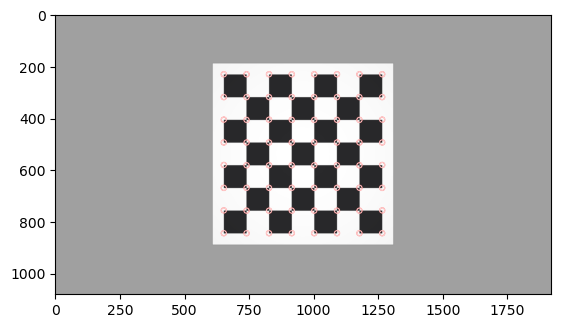

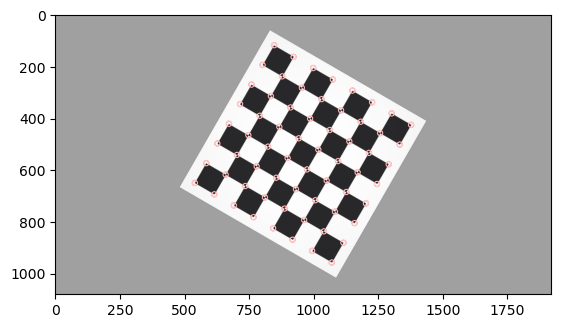

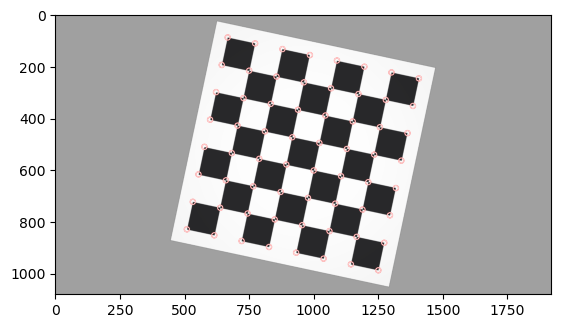

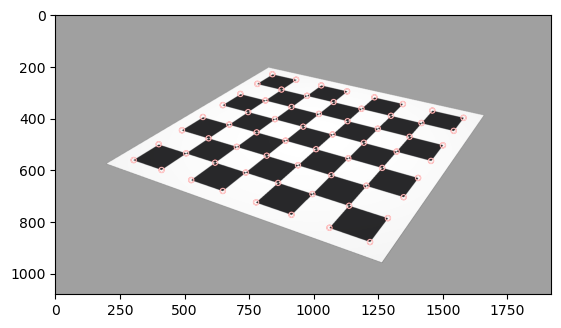

In [101]:
for i,target_img in enumerate(ims):
    image = target_img.copy()
    keypoints_ = keypoints[i]
    
    for j, point in enumerate(keypoints_):
    
        cv2.circle(image, (int(point[0]), int(point[1])), 10, (255,0,0), 2)
        
    plt.imshow(image)
    plt.show()

## Compute Homography

Implement the function:

H = computeHomography(features, matches, model)

where model can be ('Euclidean', 'Similarity', 'Affine', 'Projective')

follow your notes from MIRA lessons, don't use any opencv existing function

In [102]:
import numpy as np

def computeHomography(src_points, dst_points, model):
    if type(src_points[0]) == cv2.KeyPoint or type(src_points[0]) == cv2.KeyPoint:
        src_points = [point.pt for point in src_points]
        dst_points = [point.pt for point in dst_points]

        src_points = np.array(src_points)
        dst_points = np.array(dst_points)

    # Select the appropriate homography computation
    if model == 'Euclidean':
        return computeEuclideanHomography(src_points, dst_points)
    elif model == 'Similarity':
        return computeSimilarityHomography(src_points, dst_points)
    elif model == 'Affine':
        return computeAffineHomography(src_points, dst_points)
    elif model == 'Projective':
        return computeProjectiveHomography(src_points, dst_points)
    else:
        raise ValueError("Invalid model type. Choose from 'Euclidean', 'Similarity', 'Affine', 'Projective'.")

def computeEuclideanHomography(src_points, dst_points):
    """
    Computes the Euclidean homography (translation + rotation).
    Allows 3 degrees of freedom: translation (tx, ty) and rotation (theta).
    """
    A = []
    for (x, y), (u, v) in zip(src_points, dst_points):
        A.append([x, -y, 1, 0])
        A.append([y, x, 0, 1])

    A = np.array(A)
    b = dst_points.flatten()

    # Solve using least squares
    params, _, _, _ = np.linalg.lstsq(A, b, rcond=None)
    cos_theta, sin_theta, tx, ty = params

    return np.array([
        [cos_theta, -sin_theta, tx],
        [sin_theta, cos_theta, ty],
        [0, 0, 1]
    ])

def computeSimilarityHomography(src_points, dst_points):
    """
    Computes the Similarity homography (scaling + rotation + translation).
    Allows 4 degrees of freedom: scaling (a), rotation, and translation (tx, ty).
    """
    A = []
    for (x, y), (u, v) in zip(src_points, dst_points):
        A.append([x, -y, 1, 0])
        A.append([y, x, 0, 1])

    A = np.array(A)
    b = dst_points.flatten()

    # Solve using least squares
    params, _, _, _ = np.linalg.lstsq(A, b, rcond=None)
    a, b, tx, ty = params

    return np.array([
        [a, -b, tx],
        [b, a, ty],
        [0, 0, 1]
    ])

def computeAffineHomography(src_points, dst_points):
    """
    Computes the Affine homography (linear transformation + translation).
    Allows 6 degrees of freedom: linear transformation (a11, a12, a21, a22) and translation (tx, ty).
    """
    A = []
    for (x, y), (u, v) in zip(src_points, dst_points):
        A.append([x, y, 1, 0, 0, 0])
        A.append([0, 0, 0, x, y, 1])

    A = np.array(A)
    b = dst_points.flatten()

    # Solve using LLS
    params, _, _, _ = np.linalg.lstsq(A, b, rcond=None)
    a11, a12, tx, a21, a22, ty = params

    return np.array([
        [a11, a12, tx],
        [a21, a22, ty],
        [0, 0, 1]
    ])

def computeProjectiveHomography(src_points, dst_points):
    """
    Computes the Projective homography (full 8 degrees of freedom).
    Allows 8 degrees of freedom: general projective transformation.
    """
    A = []
    for (x, y), (u, v) in zip(src_points, dst_points):
        A.append([-x, -y, -1, 0, 0, 0, u * x, u * y, u])
        A.append([0, 0, 0, -x, -y, -1, v * x, v * y, v])

    A = np.array(A)

    # Solve using SVD
    U, S, Vt = np.linalg.svd(A)
    H = Vt[-1].reshape(3, 3)
    H = H / H[2, 2]

    return H

## Compute Eucliedean Homography

Compute the Euclidean Homography between all loaded images

After computing them use the function `cv2.warpPerspective` to check the obtainen result

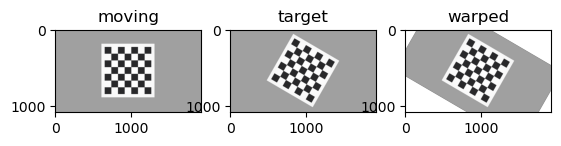

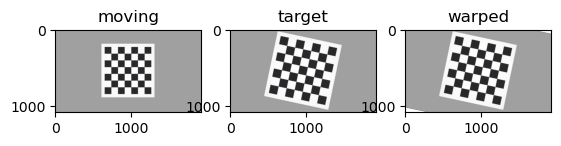

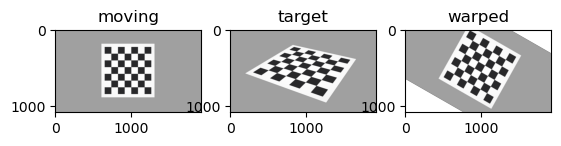

In [103]:
moving_idx = 0
moving_img = ims[moving_idx]
for i, target_img in enumerate(ims):
    if i == moving_idx:
        continue
    M = computeHomography(keypoints[moving_idx], keypoints[i], "Euclidean")
    
    warped = cv2.warpPerspective(moving_img, M, tuple(target_img.shape[:2])[::-1])
    
    fig, ax = plt.subplots(1,3)
    ax[1].imshow(target_img)
    ax[1].set_title("target")
    ax[0].imshow(moving_img)
    ax[0].set_title("moving")
    ax[2].imshow(warped)
    ax[2].set_title("warped")

## Compute Similarity Homography
Compute the Similarity Homography between all loaded images

After computing them use the function `cv2.warpPerspective` to check the obtainen result

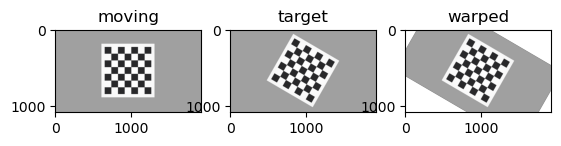

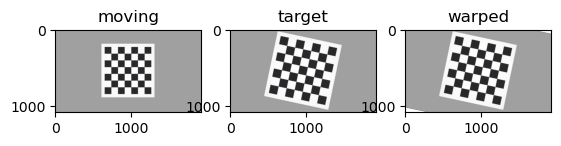

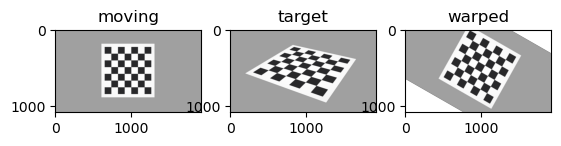

In [104]:
moving_idx = 0
moving_img = ims[moving_idx]
for i, target_img in enumerate(ims):
    if i == moving_idx:
        continue
    M = computeHomography(keypoints[moving_idx], keypoints[i], "Similarity")
    
    warped = cv2.warpPerspective(moving_img, M, tuple(target_img.shape[:2])[::-1])
    
    fig, ax = plt.subplots(1,3)
    ax[1].imshow(target_img)
    ax[1].set_title("target")
    ax[0].imshow(moving_img)
    ax[0].set_title("moving")
    ax[2].imshow(warped)
    ax[2].set_title("warped")

## Compute Affine Homography

Compute the Affine Homography between all loaded images

After computing them use the function `cv2.warpPerspective` to check the obtainen result

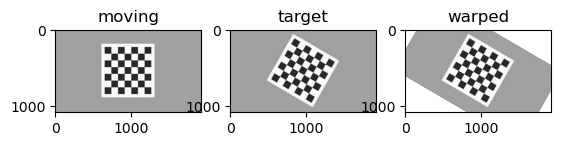

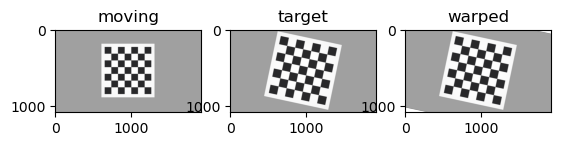

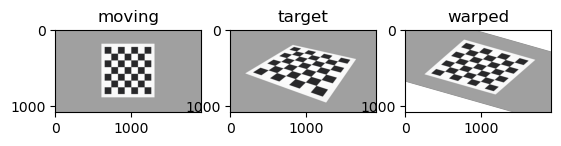

In [105]:
moving_idx = 0
moving_img = ims[moving_idx]
for i, target_img in enumerate(ims):
    if i == moving_idx:
        continue
    M = computeHomography(keypoints[moving_idx], keypoints[i], "Affine")
    
    warped = cv2.warpPerspective(moving_img, M, tuple(target_img.shape[:2])[::-1])
    
    fig, ax = plt.subplots(1,3)
    ax[1].imshow(target_img)
    ax[1].set_title("target")
    ax[0].imshow(moving_img)
    ax[0].set_title("moving")
    ax[2].imshow(warped)
    ax[2].set_title("warped")

## Compute Projective Homography

Compute the Euclidean Homography between all loaded images

After computing them use the function `cv2.warpPerspective` to check the obtainen result

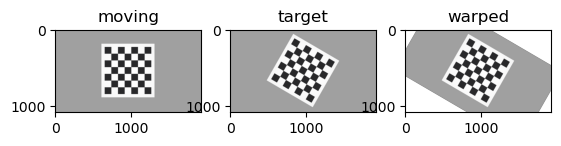

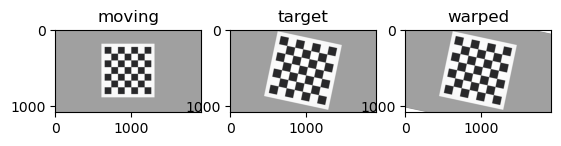

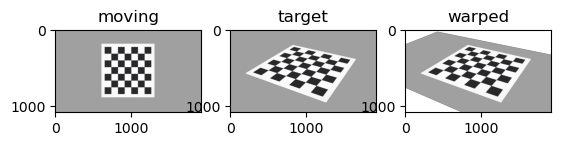

In [106]:
moving_idx = 0
moving_img = ims[moving_idx]
for i, target_img in enumerate(ims):
    if i == moving_idx:
        continue
    M = computeHomography(keypoints[moving_idx], keypoints[i], "Projective")
    
    warped = cv2.warpPerspective(moving_img, M, tuple(target_img.shape[:2])[::-1])
    
    fig, ax = plt.subplots(1,3)
    ax[1].imshow(target_img)
    ax[1].set_title("target")
    ax[0].imshow(moving_img)
    ax[0].set_title("moving")
    ax[2].imshow(warped)
    ax[2].set_title("warped")

## Comment the previous obtained results.

Which is the best homography for each image pair? Why?

$\color{red}{\text{ANSWER}}$
- 0 -> 1: '**Eucledian**' is enough, since there is only rotation (maybe translation)
- 0 -> 2: '**Eucledian**' looks good enough, but theoretically '**Similarity**' is needed, since there is rotation AND scaling (and maybe translation)
- 0 -> 3: '**Affine**' looks almost good, but the '**Projective**' gives perfect result because of the perspective change makes the 'chess table' lose its parallel lines

## Compute Homography with skin images

Now Compute the Homography between the 2 skin images used during the first sesion using your Homography Computation function. Use all models and and compare the results

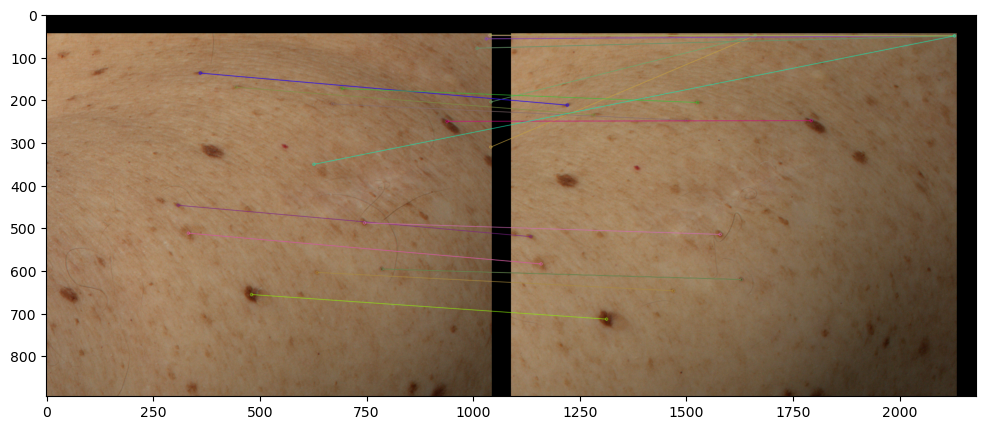

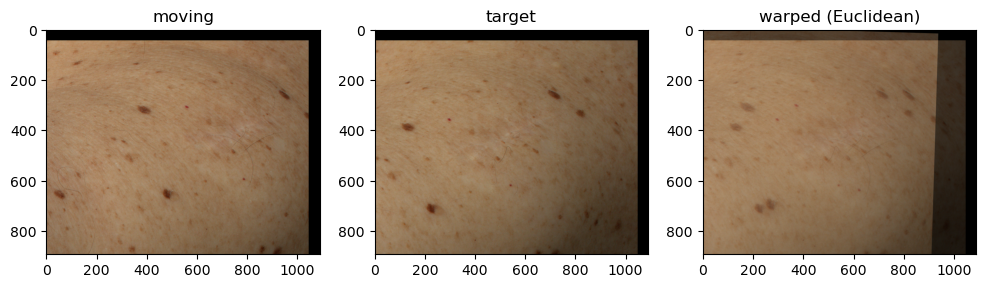

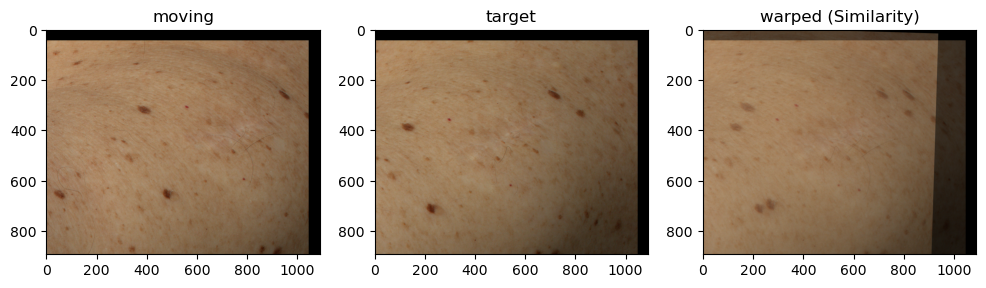

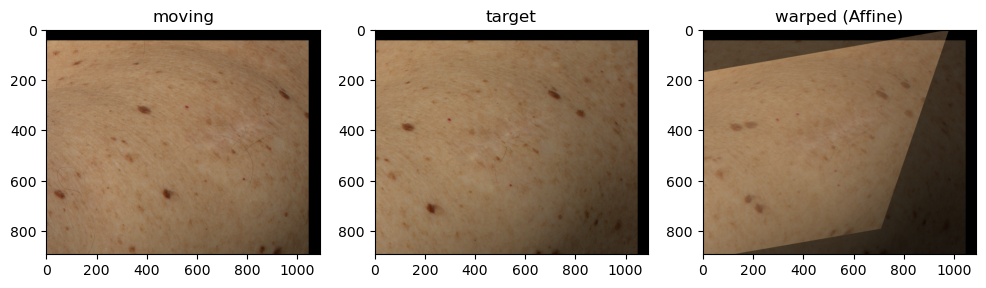

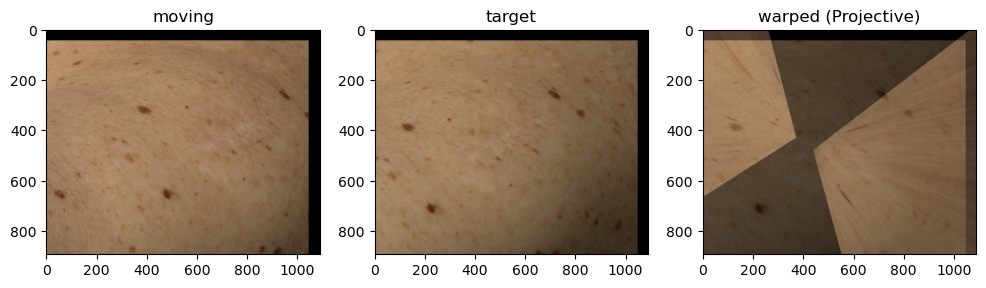

In [139]:
skin_1 = skin1()
skin_2 = skin2()

# cvt color
gray_1= cv2.cvtColor(skin_1,cv2.COLOR_BGR2GRAY)
gray_2= cv2.cvtColor(skin_2,cv2.COLOR_BGR2GRAY)

# detect
sift = cv2.SIFT_create()
kp_1, des_1 = sift.detectAndCompute(gray_1, None)
kp_2, des_2 = sift.detectAndCompute(gray_2, None)

lowe_matches = Lowe_match(des_1, des_2, ratio_thresh=0.75)
matched_image = cv2.drawMatches(skin_1, kp_1, skin_2, kp_2, lowe_matches[:], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
imshow((matched_image))

# Extract matched keypoints
dst_points = np.float32([kp_2[m.trainIdx].pt for m in lowe_matches])
src_points = np.float32([kp_1[m.queryIdx].pt for m in lowe_matches])

# Now src_points and dst_points contain the coordinates of the matched keypoints

for mode in ["Euclidean", "Similarity", "Affine", "Projective"]:
    M = computeHomography(src_points, dst_points, mode)
    warped = cv2.warpPerspective(skin_1, M, tuple(skin_1.shape[:2])[::-1])
    blended_image = blend(warped, skin_2, 0.5)

    fig, ax = plt.subplots(1, 3, figsize=(12, 12))
    ax[0].imshow(bgr2rgb(skin_1))
    ax[0].set_title("moving")
    ax[1].imshow(bgr2rgb(skin_2))
    ax[1].set_title("target")
    ax[2].imshow(bgr2rgb(blended_image))
    ax[2].set_title(f"warped ({mode})")

SMALL CUSTOM FIX:
- strip the black rim from the images before detecting keypoints (image -> black rim causes drastic gradients, meaning that the without rims we can eliminate the outliers)

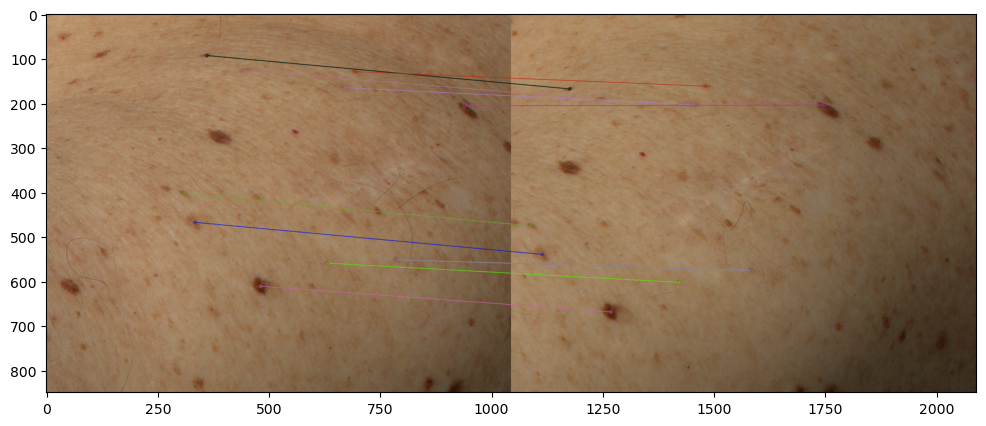

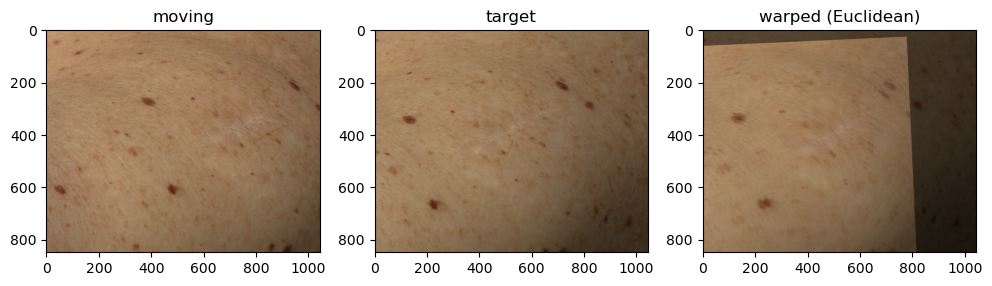

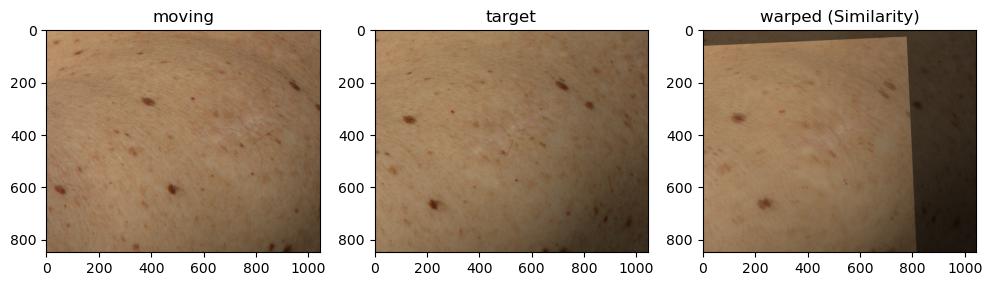

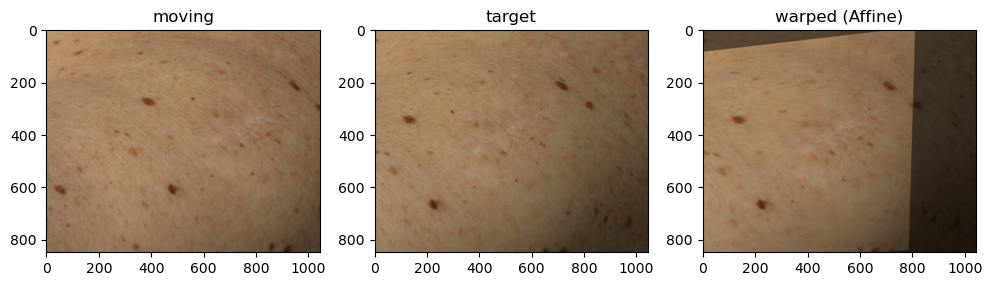

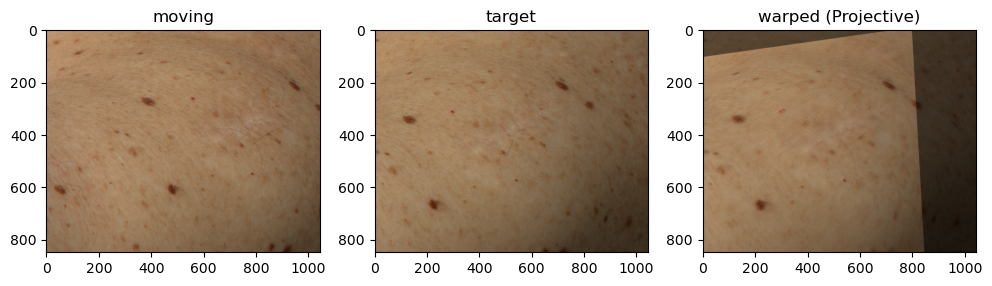

In [141]:
skin_1 = strip_black_rim(skin1())
skin_2 = strip_black_rim(skin2())

# cvt color
gray_1= cv2.cvtColor(skin_1,cv2.COLOR_BGR2GRAY)
gray_2= cv2.cvtColor(skin_2,cv2.COLOR_BGR2GRAY)

# detect
sift = cv2.SIFT_create()
kp_1, des_1 = sift.detectAndCompute(gray_1, None)
kp_2, des_2 = sift.detectAndCompute(gray_2, None)

lowe_matches = Lowe_match(des_1, des_2, ratio_thresh=0.75)
matched_image = cv2.drawMatches(skin_1, kp_1, skin_2, kp_2, lowe_matches[:], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
imshow(matched_image)

# Extract matched keypoints
dst_points = np.float32([kp_2[m.trainIdx].pt for m in lowe_matches])
src_points = np.float32([kp_1[m.queryIdx].pt for m in lowe_matches])

# Now src_points and dst_points contain the coordinates of the matched keypoints

for mode in ["Euclidean", "Similarity", "Affine", "Projective"]:
    M = computeHomography(src_points, dst_points, mode)
    warped = cv2.warpPerspective(skin_1, M, tuple(skin_1.shape[:2])[::-1])
    blended_image = blend(warped, skin_2, 0.5)

    fig, ax = plt.subplots(1, 3, figsize=(12, 12))
    ax[0].imshow(bgr2rgb(skin_1))
    ax[0].set_title("moving")
    ax[1].imshow(bgr2rgb(skin_2))
    ax[1].set_title("target")
    ax[2].imshow(bgr2rgb(blended_image))
    ax[2].set_title(f"warped ({mode})")

## You should notice that you have outliers when you compute the Homography.

Implement RANSAC function and recompute all the Homographies using it.

Finally Warp one of the images and compare your results with the ones obtained using opencv functions.

In [150]:
from math import comb

def ransac_homography_with_mode(src_points, dst_points, mode='Projective', n_iter=25000, threshold=3.0):
    best_inliers = []
    best_H = None
    best_error = np.inf
    used_subsets = set()

    # Min number of samples needed changes depending on the mode
    match mode:
        case 'Projective':
            n_samples = 8
        case 'Affine':
            n_samples = 6
        case 'Similarity':
            n_samples = 4
        case 'Euclidean':
            n_samples = 3
        case _:
            raise ValueError("Invalid model type. Choose from 'Euclidean', 'Similarity', 'Affine', 'Projective'.")

    # Calculate the total number of unique combinations
    total_combinations = comb(len(src_points), n_samples)

    for _ in range(n_iter):
        # Terminate if all combinations have been used
        if len(used_subsets) == total_combinations:
            print(f"All subsets have been exhausted in iteration {_}.")
            break

        # Generate a random subset that hasn't been used
        while True:
            subset = list(sorted(np.random.choice(len(src_points), size=n_samples, replace=False)))
            if tuple(subset) not in used_subsets:
                used_subsets.add(tuple(subset))
                break

        src_subset = src_points[subset]
        dst_subset = dst_points[subset]

        try:
            # Compute the homography using the selected model
            H = computeHomography(src_subset, dst_subset, mode)
        except np.linalg.LinAlgError:
            # Skip this iteration if matrix computation fails
            continue

        # Apply transformation to all points
        transformed_points = cv2.perspectiveTransform(src_points.reshape(-1, 1, 2), H)
        errors = np.linalg.norm(dst_points - transformed_points.squeeze(), axis=1)
        sum_error = np.sum(errors)

        # Count inliers
        inliers = np.where(errors < threshold)[0]

        # Update the best model if more inliers are found
        if len(inliers) >= len(best_inliers) and sum_error < best_error:
            best_inliers = inliers
            best_H = H
            best_error = sum_error

    # Recompute homography with all inliers
    # final_H = computeHomography(src_points[best_inliers], dst_points[best_inliers], mode)
    return best_H, best_inliers


In [151]:
def draw_matches(image1, keypoints1, image2, keypoints2, matches, inliers):
    # Ensure keypoints are cv2.KeyPoint objects
    assert isinstance(keypoints1[0], cv2.KeyPoint), "Keypoints1 must be cv2.KeyPoint objects"
    assert isinstance(keypoints2[0], cv2.KeyPoint), "Keypoints2 must be cv2.KeyPoint objects"

    # Create masks for inliers and outliers
    inlier_mask = np.zeros(len(matches), dtype=bool)
    inlier_mask[inliers] = True

    # Separate inliers and outliers
    inlier_matches = [matches[i] for i in range(len(matches)) if inlier_mask[i]]
    outlier_matches = [matches[i] for i in range(len(matches)) if not inlier_mask[i]]

    # Draw matches
    inlier_img = cv2.drawMatches(image1, keypoints1, image2, keypoints2, inlier_matches[:], None, matchColor=(0, 255, 0), flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    outlier_img = cv2.drawMatches(image1, keypoints1, image2, keypoints2, outlier_matches[:], None, matchColor=(0, 0, 255), flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    return inlier_img, outlier_img

### Unstripped

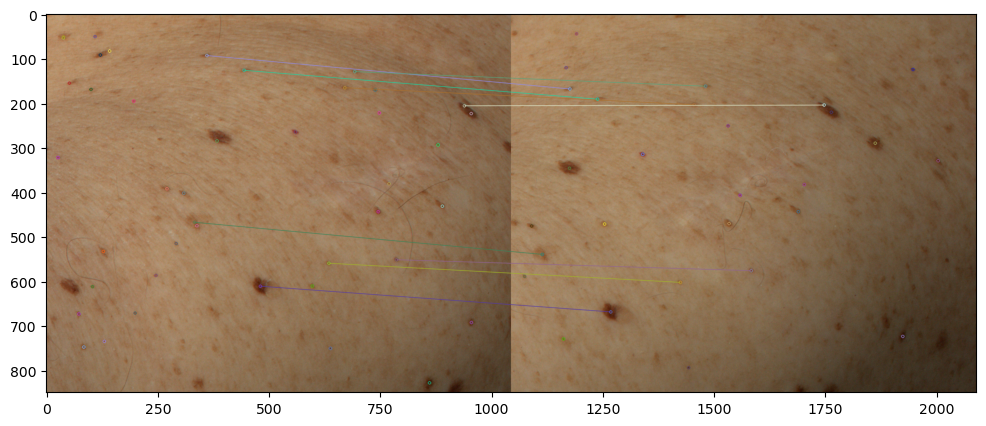

Euclidean
All subsets have been exhausted in iteration 84.


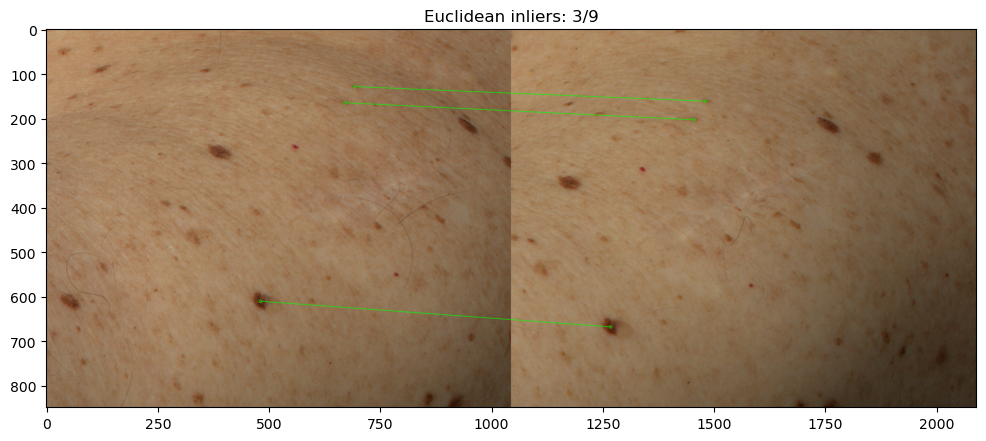

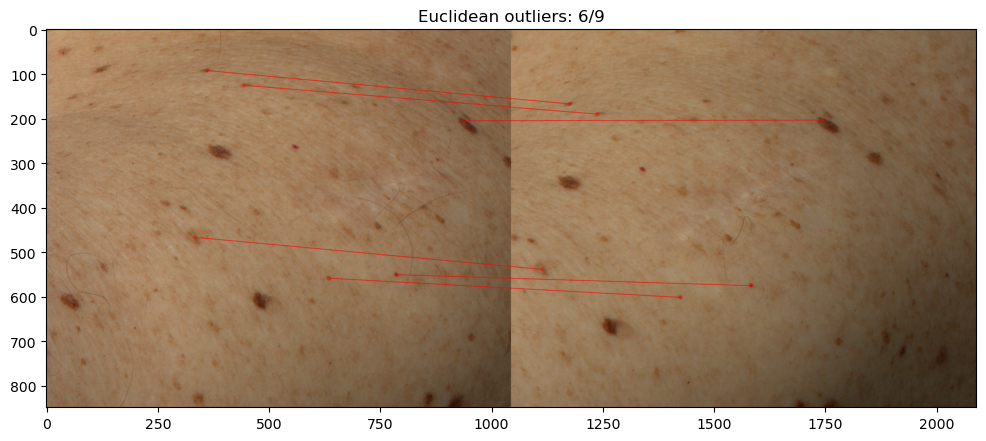

Similarity
All subsets have been exhausted in iteration 126.


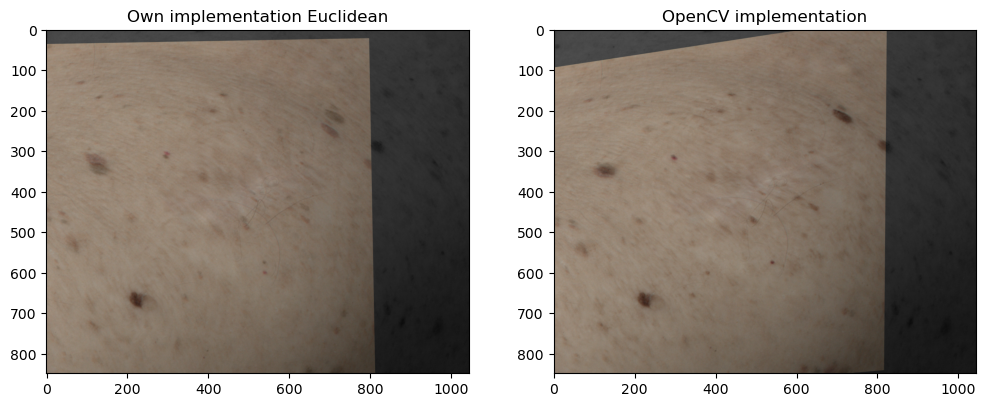

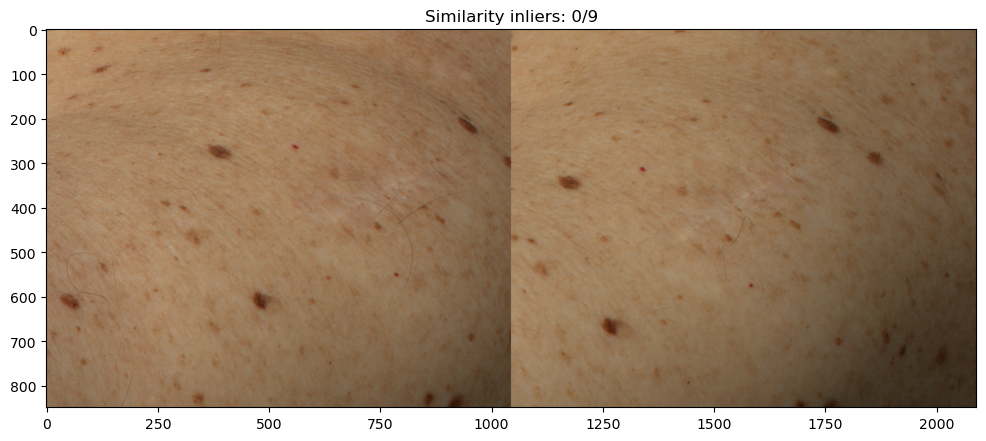

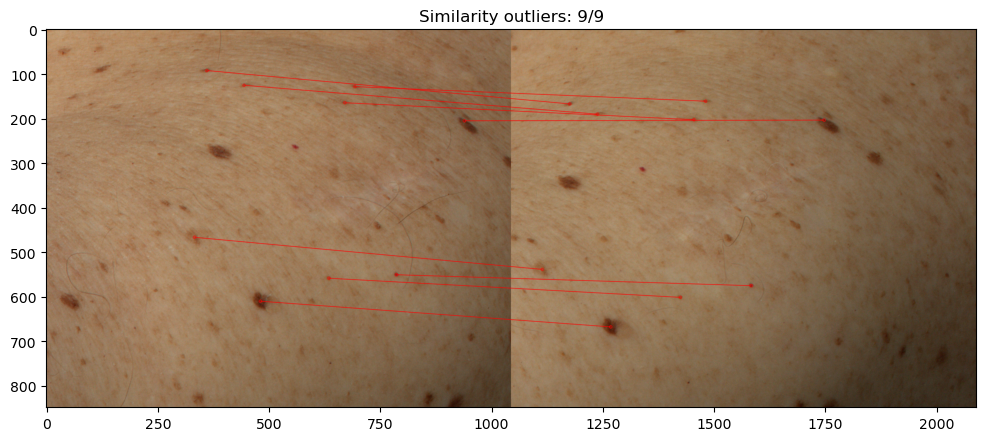

Affine
All subsets have been exhausted in iteration 84.


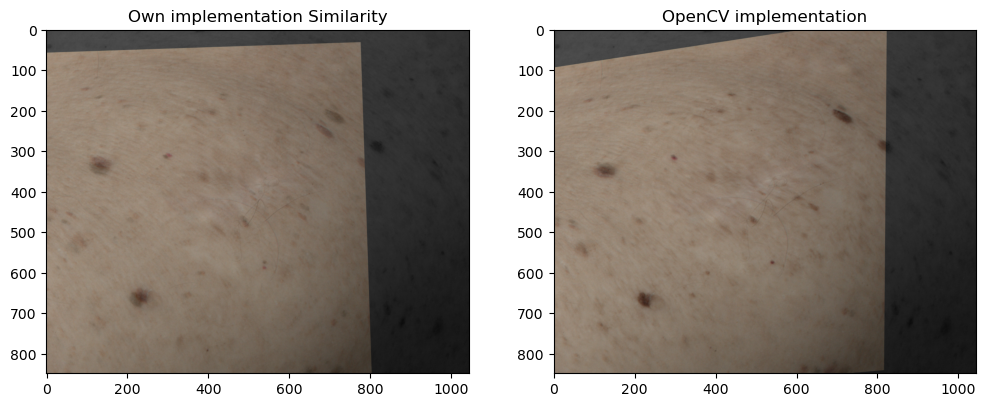

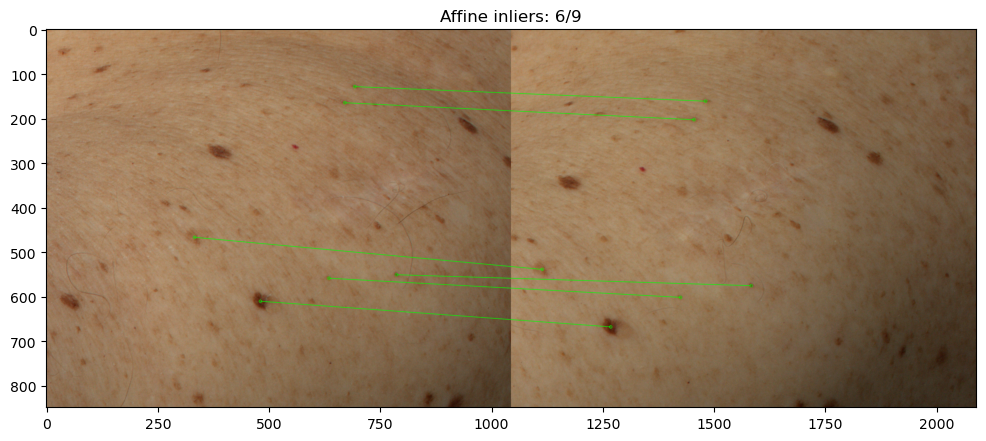

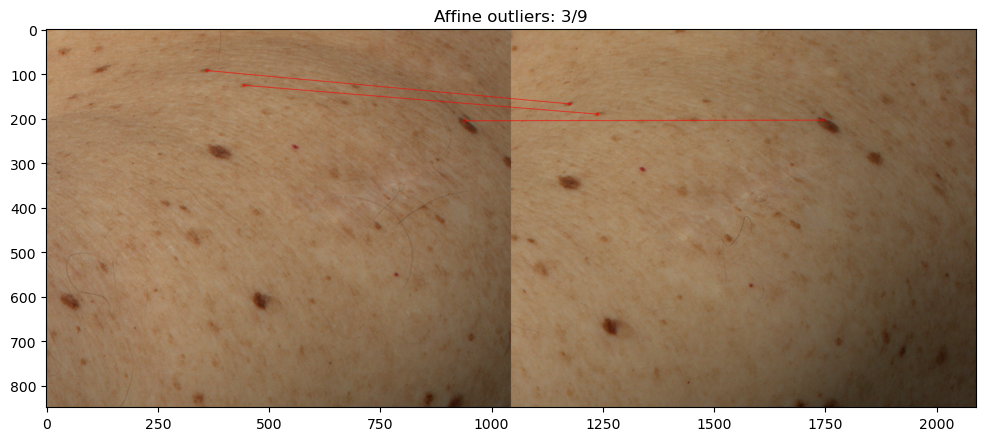

Projective
All subsets have been exhausted in iteration 9.


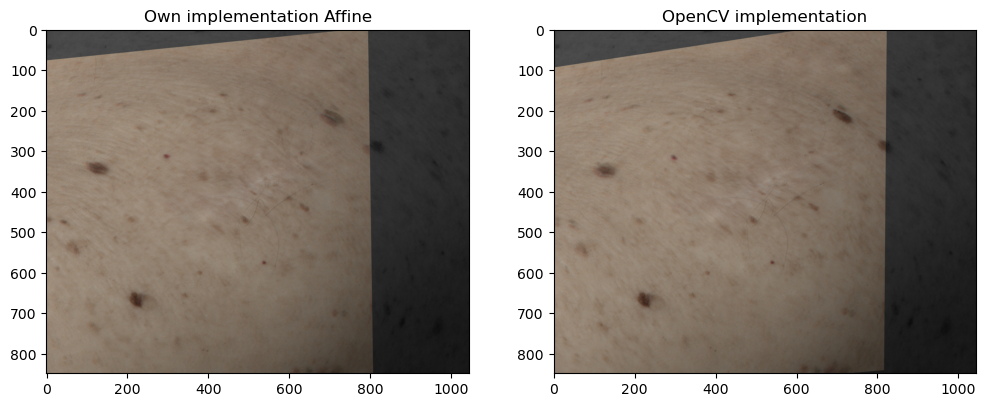

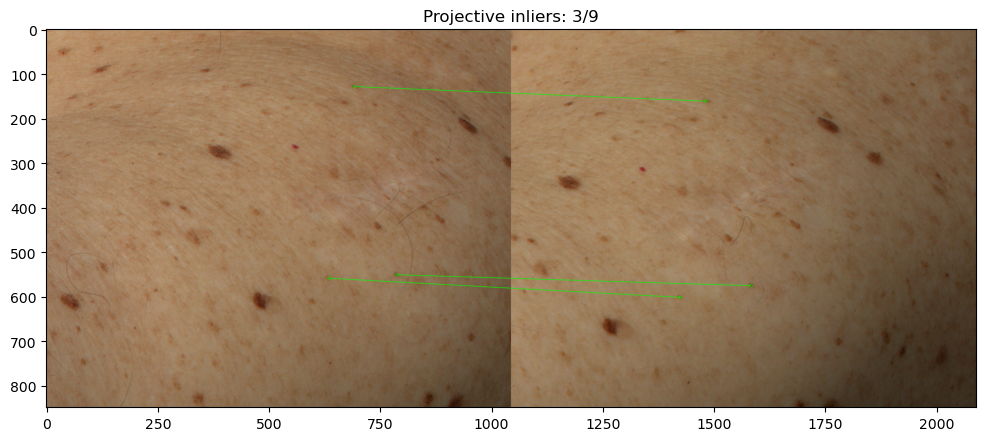

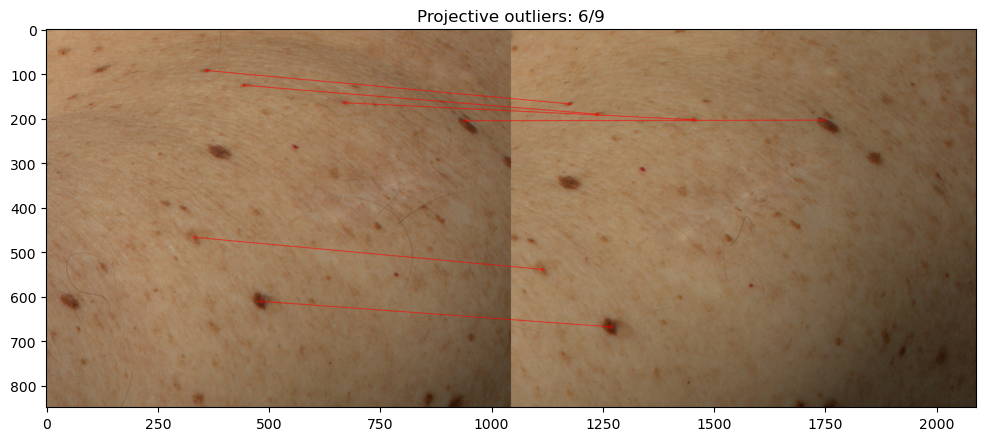

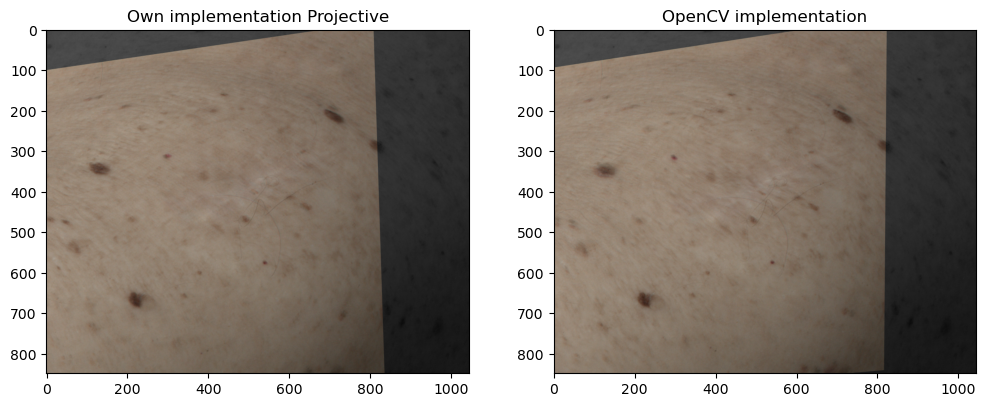

In [166]:
skin_1 = strip_black_rim(skin1())
skin_2 = strip_black_rim(skin2())

# cvt color
gray_1 = cv2.cvtColor(skin_1, cv2.COLOR_BGR2GRAY)
gray_2 = cv2.cvtColor(skin_2, cv2.COLOR_BGR2GRAY)

# detect
sift = cv2.SIFT_create()
kp_1, des_1 = sift.detectAndCompute(gray_1, None)
kp_2, des_2 = sift.detectAndCompute(gray_2, None)

# Keypoint threshold should not be closer to 1/20 of the larger image dimensionS
corner_th = np.max(gray_1.shape) * 0.05
ratio_th = 0.7

# Extract matching keypoints
lowe_matches = Lowe_match(des_1, des_2, ratio_thresh=ratio_th)

# Display matches
matched_image = cv2.drawMatches(cv2.cvtColor(skin_1, cv2.COLOR_BGR2RGB), kp_1, cv2.cvtColor(skin_2, cv2.COLOR_BGR2RGB), kp_2, lowe_matches[:], None, flags=cv2.DRAW_MATCHES_FLAGS_DEFAULT)
imshow(bgr2rgb(matched_image))

# Extract matched keypoints
dst_points = np.float32([kp_2[m.trainIdx].pt for m in lowe_matches])
src_points = np.float32([kp_1[m.queryIdx].pt for m in lowe_matches])

# OpenCV implementation for reference
H1, status = cv2.findHomography(src_points, dst_points, cv2.RANSAC)
warped_cv = cv2.warpPerspective(skin_1, H1, tuple(skin_2.shape[:2])[::-1])

for mode in ["Euclidean", "Similarity", "Affine", "Projective"]:
    print(mode)
    final_H, inliers = ransac_homography_with_mode(src_points, dst_points, mode=mode)

    inlier_img, outlier_img = draw_matches(skin_1, kp_1, skin_2, kp_2, lowe_matches, inliers)

    imshow(inlier_img, title=f"{mode} inliers: {len(inliers)}/{len(lowe_matches)}")
    imshow(outlier_img, title=f"{mode} outliers: {len(lowe_matches) - len(inliers)}/{len(lowe_matches)}")

    warped = cv2.warpPerspective(skin_1, final_H, tuple(skin_2.shape[:2])[::-1])
    blended_image = blend(warped, np.dstack([gray_2, gray_2, gray_2]), 0.5)

    fig, ax = plt.subplots(1, 2, figsize=(12, 12))
    ax[0].imshow(bgr2rgb(blended_image))
    ax[0].set_title(f"Own implementation {mode}")
    ax[1].imshow(bgr2rgb(blend(warped_cv, np.dstack([gray_2, gray_2, gray_2]), 0.5)))
    ax[1].set_title(f"OpenCV implementation")

### Stripped

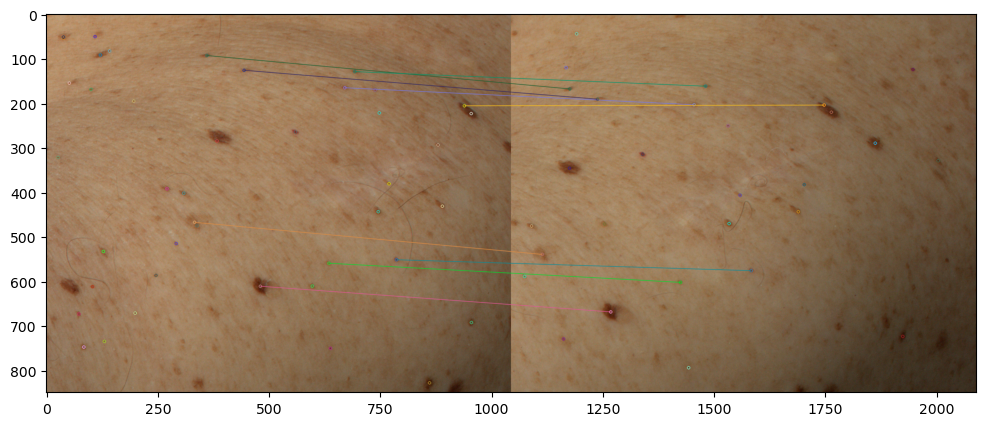

Euclidean
All subsets have been exhausted in iteration 84.


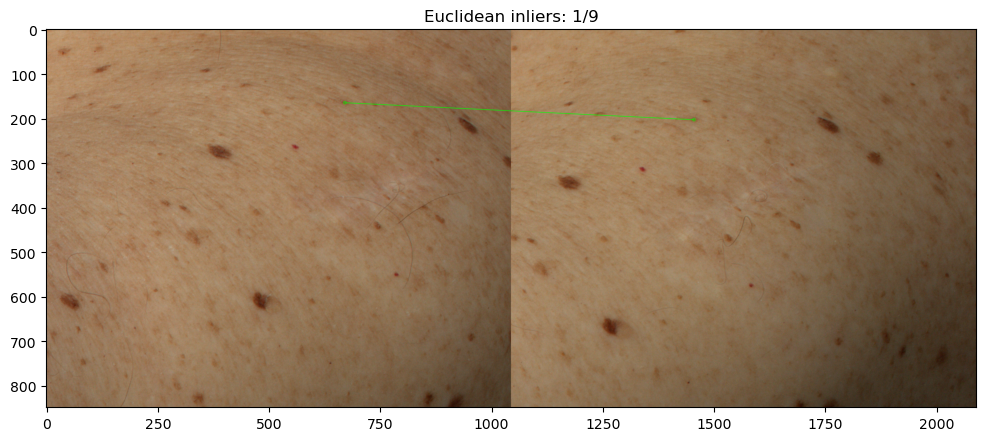

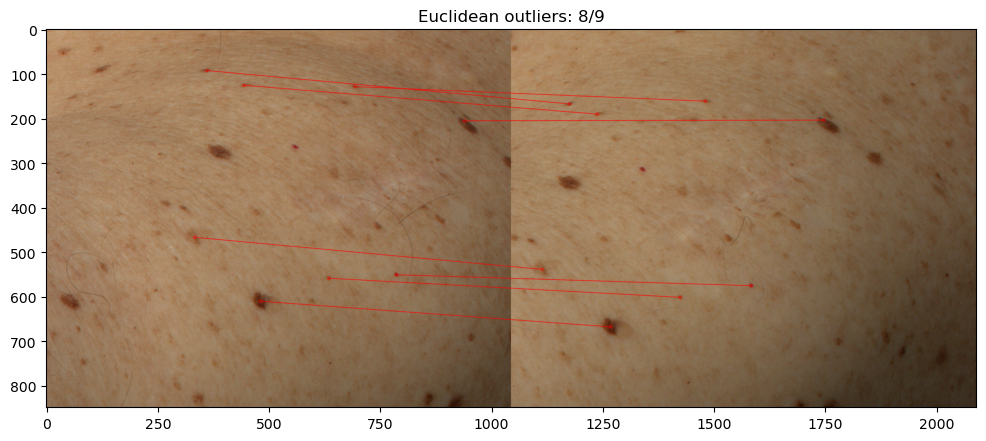

Similarity
All subsets have been exhausted in iteration 126.


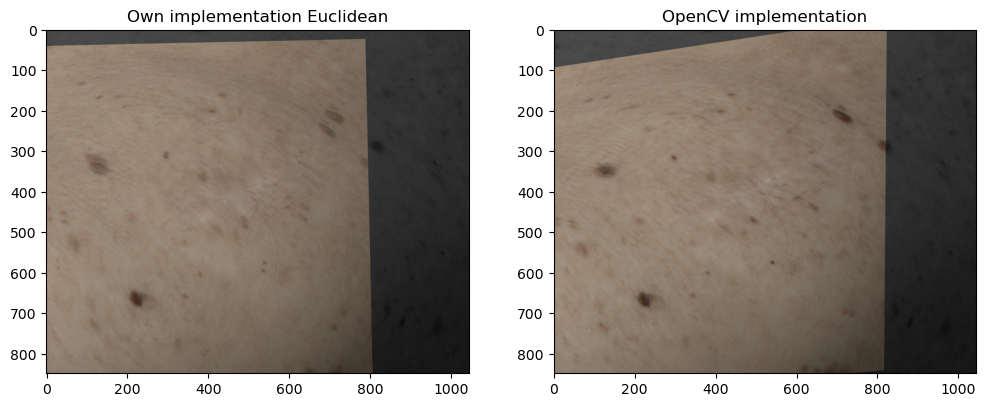

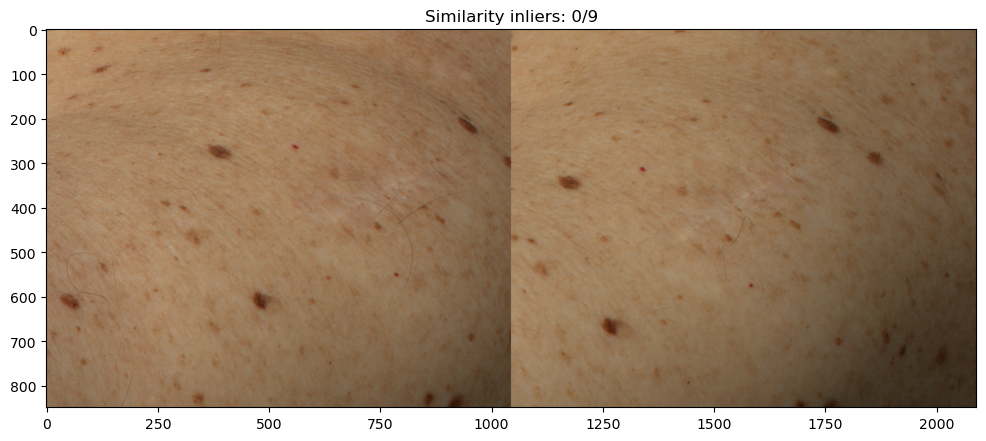

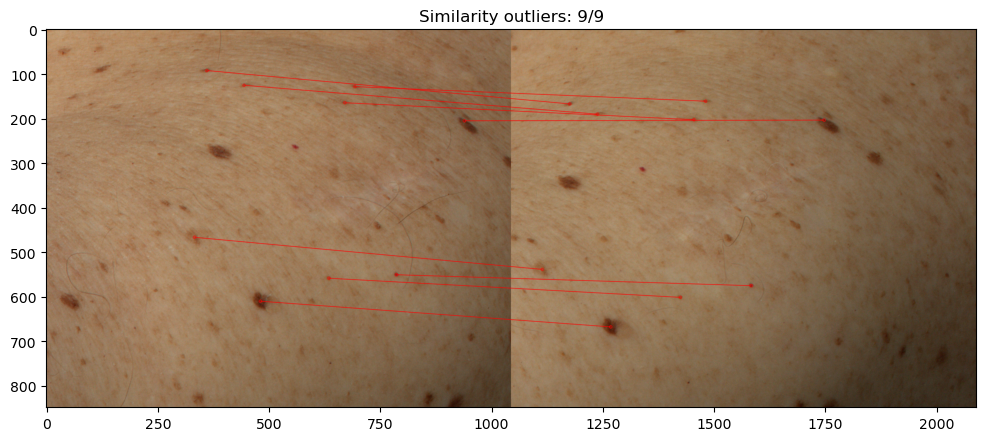

Affine
All subsets have been exhausted in iteration 84.


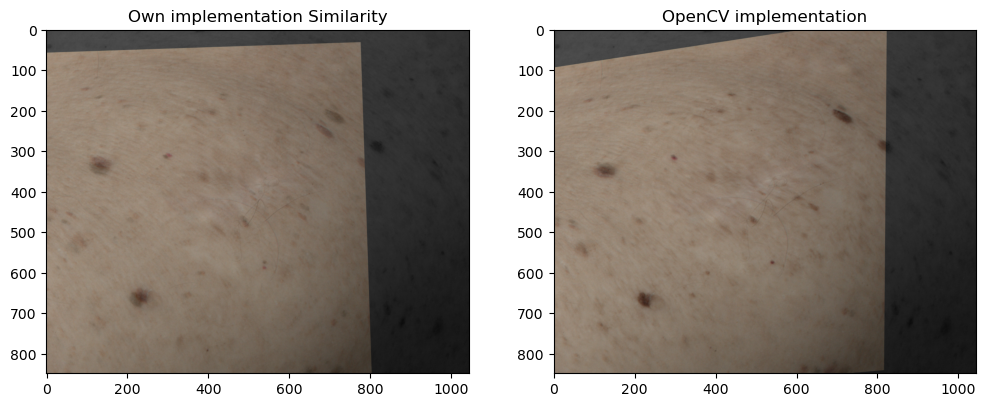

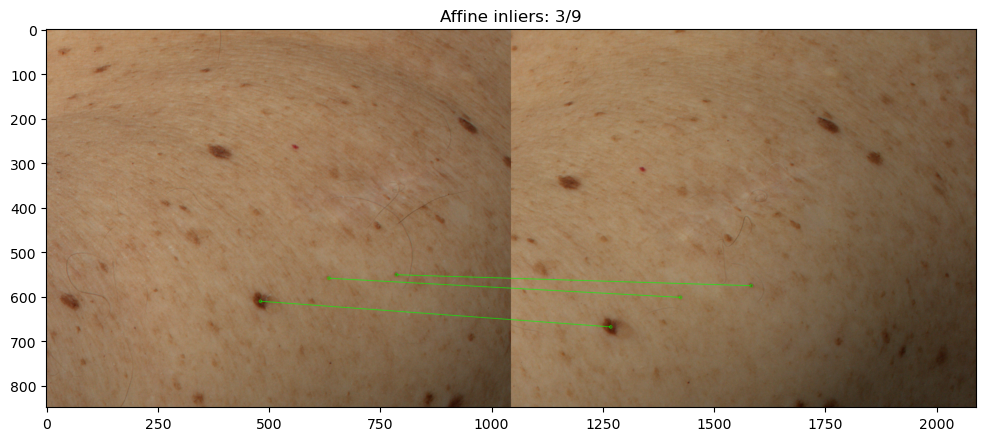

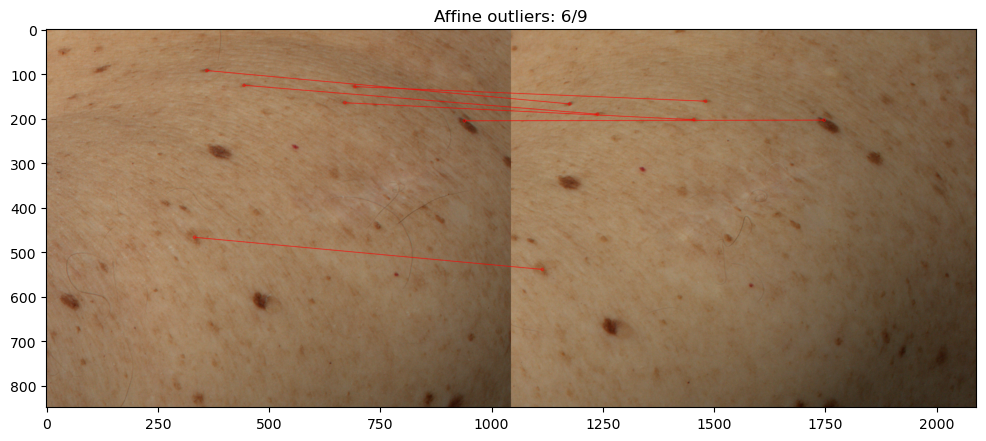

Projective
All subsets have been exhausted in iteration 9.


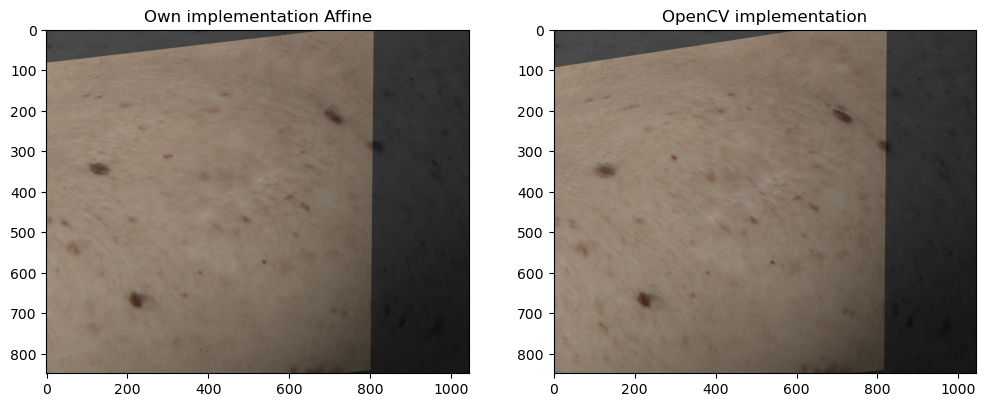

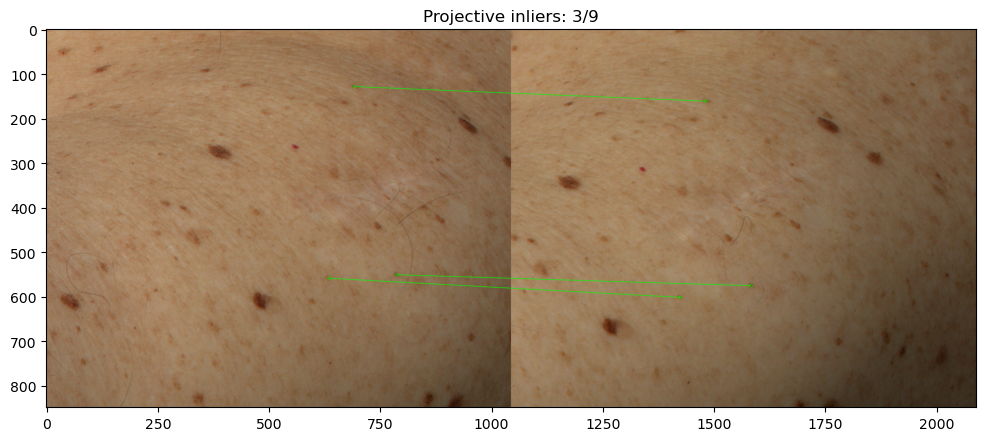

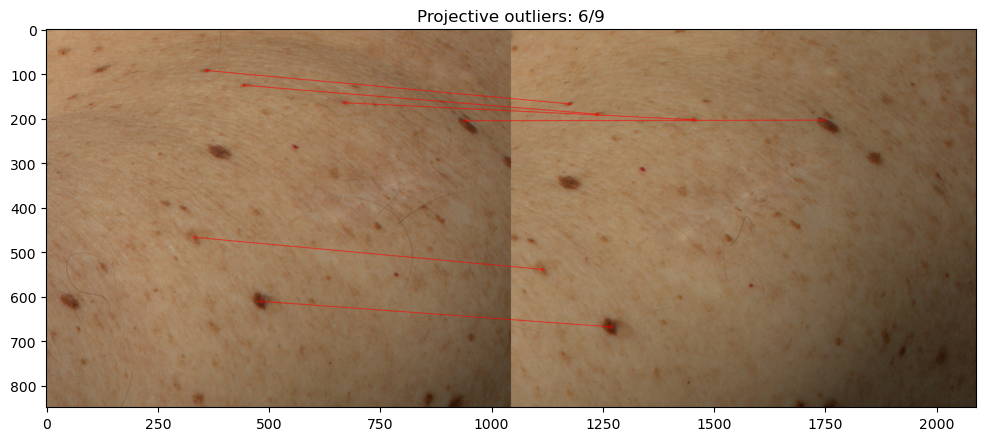

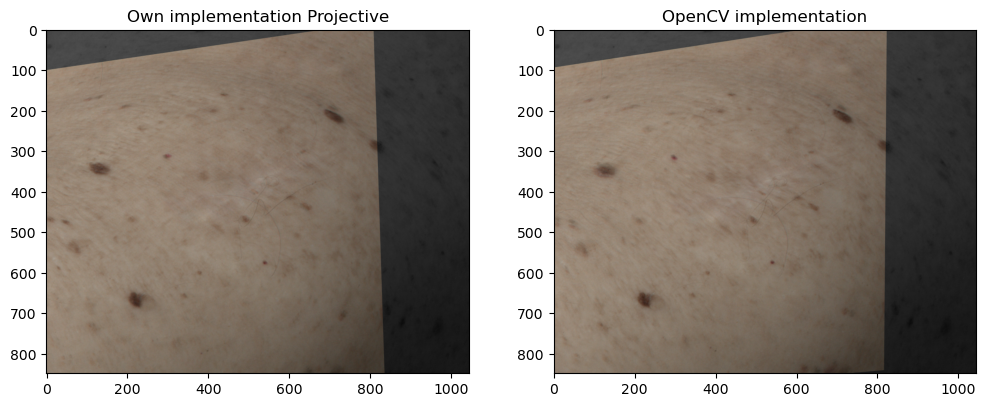

In [167]:
skin_1 = strip_black_rim(skin1())
skin_2 = strip_black_rim(skin2())

# cvt color
gray_1= cv2.cvtColor(skin_1, cv2.COLOR_BGR2GRAY)
gray_2= cv2.cvtColor(skin_2, cv2.COLOR_BGR2GRAY)

# detect
sift = cv2.SIFT_create()
kp_1, des_1 = sift.detectAndCompute(gray_1, None)
kp_2, des_2 = sift.detectAndCompute(gray_2, None)

# Keypoint threshold should not be closer to 1/20 of the larger image dimensionS
corner_th = np.max(gray_1.shape) * 0.05
ratio_th = 0.7

# Extract matching keypoints
lowe_matches = Lowe_match(des_1, des_2, ratio_thresh=ratio_th)

# Display matches
matched_image = cv2.drawMatches(cv2.cvtColor(skin_1, cv2.COLOR_BGR2RGB), kp_1, cv2.cvtColor(skin_2, cv2.COLOR_BGR2RGB), kp_2, lowe_matches[:], None, flags=cv2.DRAW_MATCHES_FLAGS_DEFAULT)
imshow(bgr2rgb(matched_image))

# Extract matched keypoints
dst_points = np.float32([kp_2[m.trainIdx].pt for m in lowe_matches])
src_points = np.float32([kp_1[m.queryIdx].pt for m in lowe_matches])

# OpenCV implementation for reference
H1, status = cv2.findHomography(src_points, dst_points, cv2.RANSAC)
warped_cv = cv2.warpPerspective(skin_1, H1, tuple(skin_2.shape[:2])[::-1])

for mode in ["Euclidean", "Similarity", "Affine", "Projective"]:
    print(mode)
    final_H, inliers = ransac_homography_with_mode(src_points, dst_points, mode=mode)

    inlier_img, outlier_img = draw_matches(skin_1, kp_1, skin_2, kp_2, lowe_matches, inliers)

    imshow(inlier_img, title=f"{mode} inliers: {len(inliers)}/{len(lowe_matches)}")
    imshow(outlier_img, title=f"{mode} outliers: {len(lowe_matches)-len(inliers)}/{len(lowe_matches)}")

    warped = cv2.warpPerspective(skin_1, final_H, tuple(skin_2.shape[:2])[::-1])
    blended_image = blend(warped, np.dstack([gray_2,gray_2,gray_2]), 0.5)

    fig, ax = plt.subplots(1, 2, figsize=(12,12))
    ax[0].imshow(bgr2rgb(blended_image))
    ax[0].set_title(f"Own implementation {mode}")
    ax[1].imshow(bgr2rgb(blend(warped_cv, np.dstack([gray_2,gray_2,gray_2]), 0.5)))
    ax[1].set_title(f"OpenCV implementation")

## Extra Work

There are many ways to apply *Deep Learning* for registering images. Do some research and find a solution that uses it and apply it to skin1 and skin2 images.


## Congratulations!
In this lab you:
- tested SIFT Algorithm
- implemented homography computation

Submit this notebook by the lab deadline, with the cells executed and including your **answers** in the text fields in $\color{red}{\text{red}}$ color.